# **School dropout predictive model**

Using the database MEN ESTADÍSTICAS EN EDUCACIÓN EN PREESCOLAR, BÁSICA Y MEDIA POR MUNICIPIO provided by Datos abiertos, it is going to be build a predictive model to get the school dropout.


### **Imports**

In [1]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

## **Database**

In [2]:
df = pd.read_csv('MEN_ESTADISTICAS_EN_EDUCACION_EN_PREESCOLAR__B_SICA_Y_MEDIA_POR_MUNICIPIO.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11219 entries, 0 to 11218
Data columns (total 41 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   AÑO                          11219 non-null  int64  
 1   CÓDIGO_MUNICIPIO             11219 non-null  int64  
 2   MUNICIPIO                    11219 non-null  object 
 3   CÓDIGO_DEPARTAMENTO          11219 non-null  int64  
 4   DEPARTAMENTO                 11219 non-null  object 
 5   CÓDIGO_ETC                   11219 non-null  int64  
 6   ETC                          11219 non-null  object 
 7   POBLACIÓN_5_16               11213 non-null  float64
 8   TASA_MATRICULACIÓN_5_16      11104 non-null  float64
 9   COBERTURA_NETA               11108 non-null  float64
 10  COBERTURA_NETA_TRANSICIÓN    11167 non-null  float64
 11  COBERTURA_NETA_PRIMARIA      11128 non-null  float64
 12  COBERTURA_NETA_SECUNDARIA    11125 non-null  float64
 13  COBERTURA_NETA_M

In [3]:
df.columns

Index(['AÑO', 'CÓDIGO_MUNICIPIO', 'MUNICIPIO', 'CÓDIGO_DEPARTAMENTO',
       'DEPARTAMENTO', 'CÓDIGO_ETC', 'ETC', 'POBLACIÓN_5_16',
       'TASA_MATRICULACIÓN_5_16', 'COBERTURA_NETA',
       'COBERTURA_NETA_TRANSICIÓN', 'COBERTURA_NETA_PRIMARIA',
       'COBERTURA_NETA_SECUNDARIA', 'COBERTURA_NETA_MEDIA', 'COBERTURA_BRUTA',
       'COBERTURA_BRUTA_TRANSICIÓN', 'COBERTURA_BRUTA_PRIMARIA',
       'COBERTURA_BRUTA_SECUNDARIA', 'COBERTURA_BRUTA_MEDIA',
       'TAMAÑO_PROMEDIO_DE_GRUPO', 'SEDES_CONECTADAS_A_INTERNET', 'DESERCIÓN',
       'DESERCIÓN_TRANSICIÓN', 'DESERCIÓN_PRIMARIA', 'DESERCIÓN_SECUNDARIA',
       'DESERCIÓN_MEDIA', 'APROBACIÓN', 'APROBACIÓN_TRANSICIÓN',
       'APROBACIÓN_PRIMARIA', 'APROBACIÓN_SECUNDARIA', 'APROBACIÓN_MEDIA',
       'REPROBACIÓN', 'REPROBACIÓN_TRANSICIÓN', 'REPROBACIÓN_PRIMARIA',
       'REPROBACIÓN_SECUNDARIA', 'REPROBACIÓN_MEDIA', 'REPITENCIA',
       'REPITENCIA_TRANSICIÓN', 'REPITENCIA_PRIMARIA', 'REPITENCIA_SECUNDARIA',
       'REPITENCIA_MEDIA'],
   

In [4]:
df.head(5)

,AÑO,CÓDIGO_MUNICIPIO,MUNICIPIO,CÓDIGO_DEPARTAMENTO,DEPARTAMENTO,CÓDIGO_ETC,ETC,POBLACIÓN_5_16,TASA_MATRICULACIÓN_5_16,COBERTURA_NETA,...,REPROBACIÓN,REPROBACIÓN_TRANSICIÓN,REPROBACIÓN_PRIMARIA,REPROBACIÓN_SECUNDARIA,REPROBACIÓN_MEDIA,REPITENCIA,REPITENCIA_TRANSICIÓN,REPITENCIA_PRIMARIA,REPITENCIA_SECUNDARIA,REPITENCIA_MEDIA
0,2011,5001,Medellín,5,Antioquia,3759,Medellín,386466.0,108.73,108.5,...,0.03,0.00,0.00,0.01,0.17,4.57,0.15,3.26,7.44,2.95
1,2011,5002,Abejorral,5,Antioquia,3758,Antioquia (ETC),4146.0,97.81,97.8,...,1.70,0.00,1.23,2.96,1.18,0.89,0.00,0.85,1.08,1.23
2,2011,5004,Abriaquí,5,Antioquia,3758,Antioquia (ETC),483.0,88.61,88.6,...,7.29,0.00,1.47,14.66,7.46,1.69,3.13,1.47,2.22,0.00
3,2011,5021,Alejandría,5,Antioquia,3758,Antioquia (ETC),702.0,118.52,118.5,...,3.58,0.00,2.16,4.39,8.04,0.60,0.00,0.96,0.00,0.00
4,2011,5030,Amagá,5,Antioquia,3758,Antioquia (ETC),6631.0,78.65,78.7,...,8.99,0.24,6.73,14.46,7.45,0.42,0.00,0.24,0.91,0.00


## **Graphic analysis**

In [5]:
#Fixing some data
df = df.replace({"DEPARTAMENTO": "Bogotá D.C."}, "Bogotá, D.C.")
df = df.replace({"DEPARTAMENTO": "Archipiélago de San Andrés. Providencia y Santa Catalina"}, "Archipiélago de San Andrés, Providencia y Santa Catalina")
df = df.replace({"DEPARTAMENTO": "Archipiélago de San Andrés, Providencia y Santa Catalina"}, "Islas")

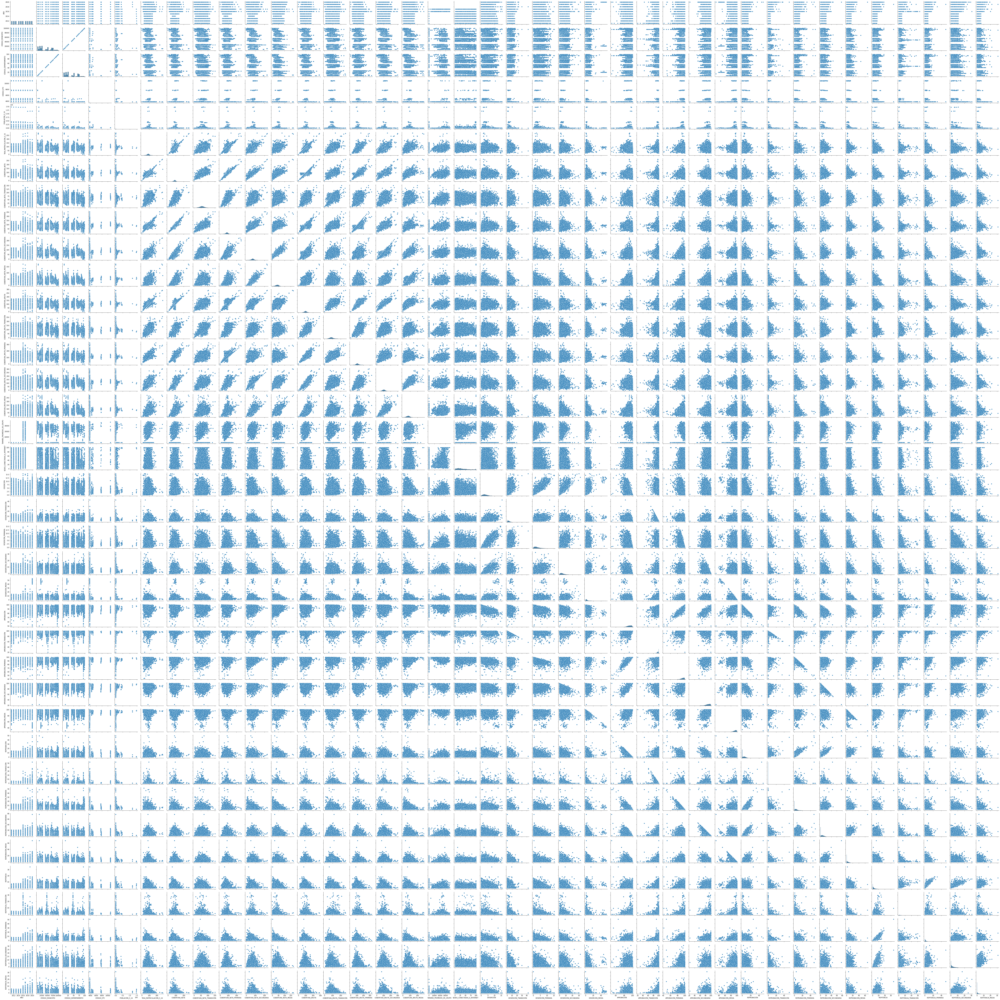

In [6]:
fig  = sns.pairplot(data = df)

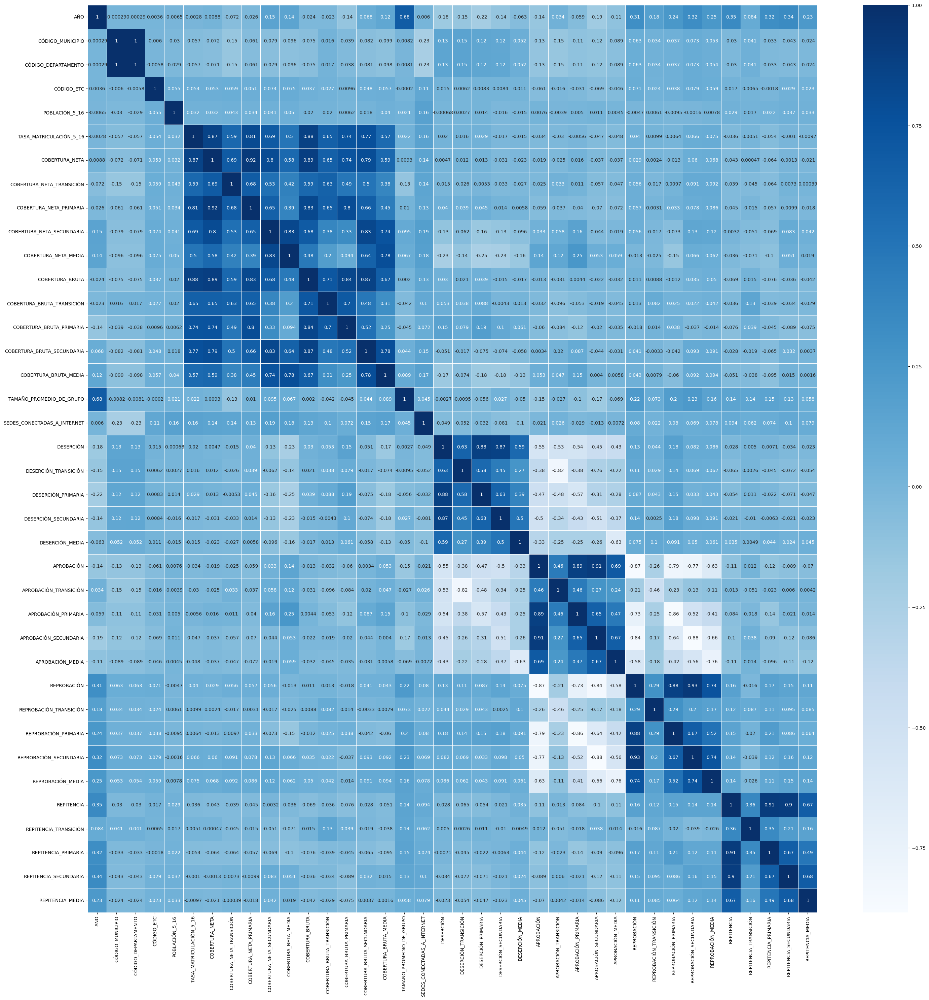

In [7]:
fig, ax = plt.subplots(figsize=(35,35))       
fig1 = sns.heatmap(df.corr(),annot = True,linewidths=.5, cmap = 'Blues',ax = ax)

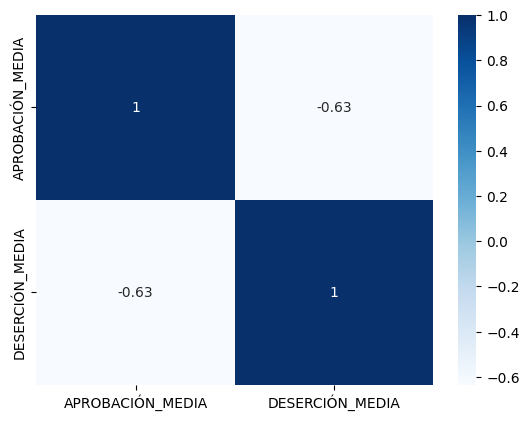

In [8]:
df_mod = df[['DEPARTAMENTO','APROBACIÓN_MEDIA','DESERCIÓN_MEDIA']]
fig1 = sns.heatmap(df_mod.corr(),annot = True, cmap = 'Blues')

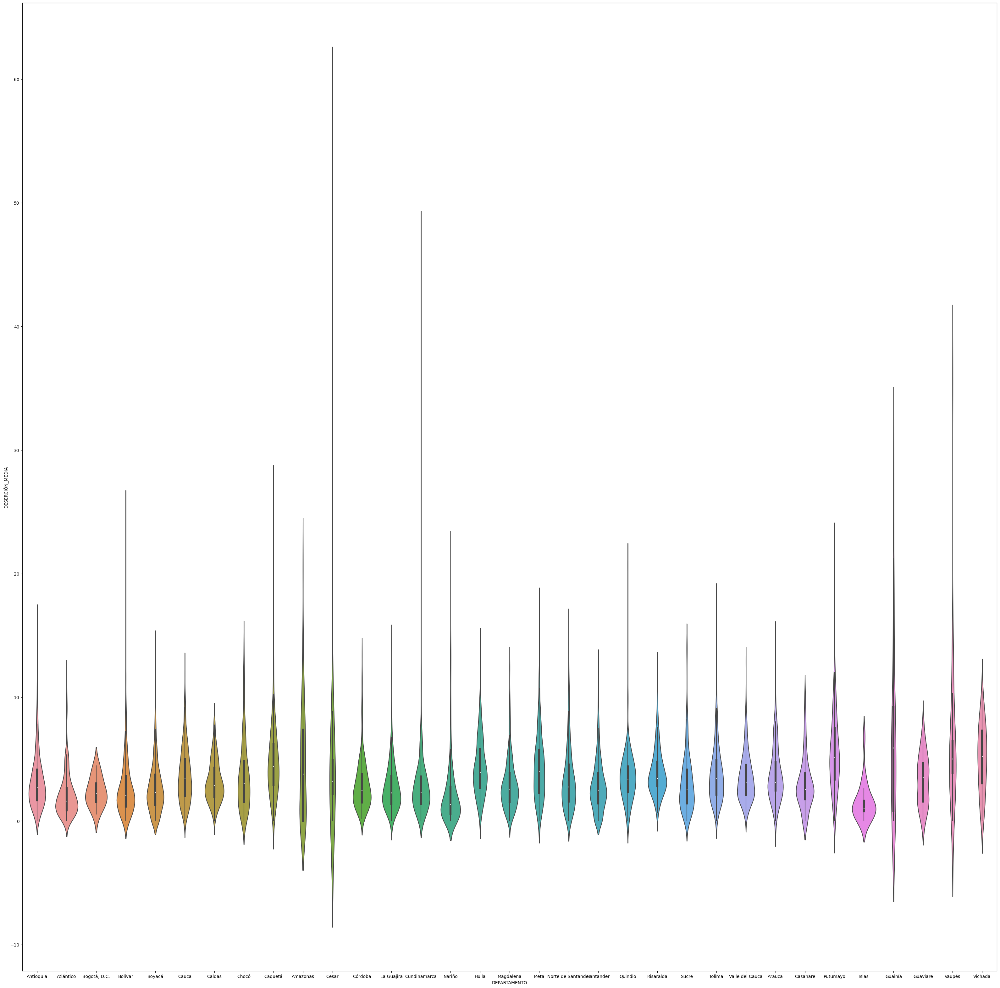

In [10]:
f, ax = plt.subplots(figsize=(40, 40))
fig = sns.violinplot(data = df, x  ="DEPARTAMENTO", y = "DESERCIÓN_MEDIA",ax = ax)

## **Filtering**

In [11]:
cols = ['DEPARTAMENTO','DESERCIÓN_MEDIA','APROBACIÓN_MEDIA'];
df_model = df[cols]
df_model = df_model.dropna()

## **Getting dummy variables**

In [12]:
dept = pd.get_dummies(df_model.DEPARTAMENTO, prefix='DEPARTAMENTO')
df_model = df_model.join(dept)
df_model.drop(['DEPARTAMENTO'], axis=1, inplace=True)

## **Creating output column**

It is going to be a classification model, so we are going to classify dropout in high dropout and low dropout. We are going to put high dropout when dropout is higher than 4 and low dropout when dropout is lower than 4.

In [13]:
df_model['DESERCIÓN_MEDIA_CAT'] = df_model['DESERCIÓN_MEDIA'].map(lambda x: 1 if x>=4 else 0)
df_model = df_model.drop(['DESERCIÓN_MEDIA'], axis = 1)

## **Creating Model**

In [14]:
# Defining input and output
X = df_model.drop(['DESERCIÓN_MEDIA_CAT'], axis = 1);
y = df_model.DESERCIÓN_MEDIA_CAT.copy();

## **Splitting data**

In [15]:

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3)

## **Training model**

In [16]:
model = LogisticRegression(max_iter=1000)
log_mod = model.fit(X_train, y_train)

## **Evaluating model**

In [17]:
log_mod.score(X_val, y_val)

0.7622533418204965

### **Cross-validation**

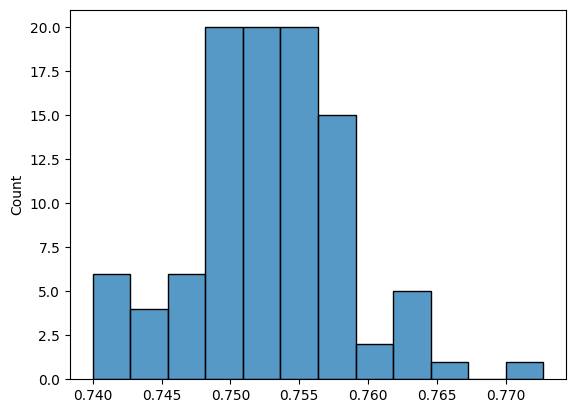

In [20]:
succ = [];
for i in range(100):
  X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.3)
  log_mod = LogisticRegression(max_iter=1000).fit(X_train, y_train);
  succ.append(log_mod.score(X_val, y_val));
sns.histplot(succ)
succ = np.array(succ);


In [21]:
np.mean(succ)

0.7528612348822408

In [22]:
np.var(succ)

3.2755726100174155e-05

# **Hypothesis**

The most rural municipalities have a higher dropout rate.

In [25]:
#Database
df = pd.read_csv('MEN_ESTADISTICAS_EN_EDUCACION_EN_PREESCOLAR__B_SICA_Y_MEDIA_POR_MUNICIPIO.csv')
cols = ['DEPARTAMENTO','DESERCIÓN_MEDIA','APROBACIÓN_MEDIA'];
df_model = df[cols]
df_model = df_model.dropna()
#Fixing some data
df_model = df_model.replace({"DEPARTAMENTO": "Bogotá D.C."}, "Bogotá, D.C.")
df_model = df_model.replace({"DEPARTAMENTO": "Archipiélago de San Andrés. Providencia y Santa Catalina"}, "Archipiélago de San Andrés, Providencia y Santa Catalina")
df_model = df_model.replace({"DEPARTAMENTO": "Archipiélago de San Andrés, Providencia y Santa Catalina"}, "Islas")
# setting up the data
dept = pd.get_dummies(df_model.DEPARTAMENTO, prefix='DEPARTAMENTO')
df_model = df_model.join(dept)
df_model = df_model[ (df_model['DEPARTAMENTO'] == 'Guainía') | (df_model['DEPARTAMENTO'] == 'Vichada') | (df_model['DEPARTAMENTO'] == 'Vaupés') | (df_model['DEPARTAMENTO'] == 'Putumayo') | (df_model['DEPARTAMENTO'] == 'Bogotá, D.C.') | (df_model['DEPARTAMENTO'] == 'Islas') | (df_model['DEPARTAMENTO'] == 'Atlántico') | (df_model['DEPARTAMENTO'] == 'Caldas')]
df_model['Resultado'] = df_model['DEPARTAMENTO'].map(lambda x: 1 if (x=='Guainía' or x=='Vichada' or x=='Vaupés' or x=='Putumayo') else 0)
dept.head()
df_model.drop(['DEPARTAMENTO','DESERCIÓN_MEDIA'], axis=1, inplace=True)
X = df_model.drop(['Resultado'], axis = 1)
Y = df_model['Resultado']
y_pred = log_mod.predict(X)

## **Confusion matrix**

<AxesSubplot:>

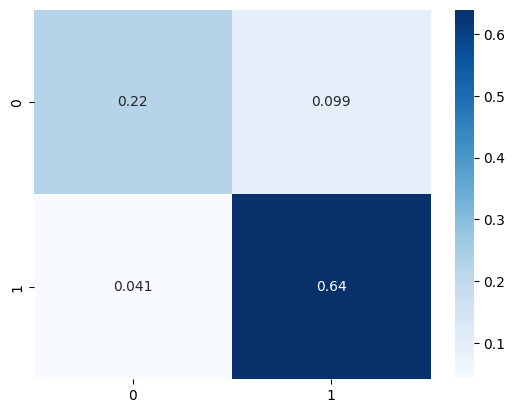

In [26]:
sns.heatmap(confusion_matrix(Y, y_pred, labels=[1, 0])/len(Y), annot = True, cmap = 'Blues')

## **Conclusion**

Based on the rurality data provided by the United Nations compared with the dropout rate and the predictive model, the hypothesis can be approved.